## Importing Modules


In [1]:
#importing modules
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("paper")
sns.set_style("darkgrid")
import json
import folium
import os
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import accuracy_score,mean_squared_error,roc_auc_score
from xgboost import XGBClassifier,XGBRegressor
import xgboost as xgb
from hyperopt import  tpe, Trials
from warnings import filterwarnings
filterwarnings('ignore')

### Ensure that directory you are running has below python and text files

1. grp_sen_spc.py
2. cty_map.py
3. xgboost_hyperopt.py
4. compare_file.csv
5. sample_file.csv
6. gz_2010_us_050_00_500k.json

In [2]:
#set your directory
path_cwd = "C:\\Users\\mihir\\Box\\COVID-19\\Analysis\\DA_MM\\Final_Run\\LR_F\\new_data\\github\\"
os.chdir(path_cwd)
os.getcwd()

#ensure these 6 files are in the location @ path_cwd
import grp_sen_spc
import cty_map
import xgboost_hyperopt as xgb_hyp
high_res_county_geo = json.load(open(path_cwd+"gz_2010_us_050_00_500k.json"))
final_dt = pd.read_csv(path_cwd+"sample_file.csv")
compare_dt = pd.read_csv(path_cwd+"compare_file.csv")

### Random Seed Assignment

In [3]:
#random seed assignment for training and testing datasets
random.seed(7988)
seed_t = [[random.randrange(1, 10000),random.randrange(10000, 20000)] for i in range(1,2,1)]
seed_m=seed_t[0][0]
seed_s=seed_t[0][1]
final_dt['Con_Ind'] = final_dt['Confirmed'].apply(lambda x: 0 if x==0.0 else 1)

## Classification
### Setup

In [4]:
#define predictors and response variables
y = final_dt[["Con_Ind"]]
X = final_dt[["TOT_POP","pop_den_permile","diab_perc","hyper_perc",             "old_perc","CRUDE_RATE","CRD_MR","Latitude","Longitude"]]
#split both classes equally in 80:20
t_size = 0.2
X_trainp, X_testp, y_trainp, y_testp = train_test_split(X[y.Con_Ind==0], y[y.Con_Ind==0], test_size= t_size, random_state=seed_m)
X_trainn, X_testn, y_trainn, y_testn = train_test_split(X[y.Con_Ind!=0], y[y.Con_Ind!=0], test_size= t_size, random_state=seed_m)
X_train = pd.concat([X_trainp,X_trainn])
X_test = pd.concat([X_testp,X_testn])
y_train = pd.concat([y_trainp,y_trainn])
y_test = pd.concat([y_testp,y_testn])


### Development of the model

In [5]:
xgb_para = dict()
xgb_para['reg_params'] = xgb_hyp.xgb_reg_params
xgb_para['fit_params'] = xgb_hyp.xgb_fit_params
xgb_para['loss_func' ] = lambda y, pred: -(roc_auc_score(y, pred))

#calling hyperopt to optimize hyperparameters
obj = xgb_hyp.HPOpt_cls(X_train, X_test, y_train, y_test)
result, tr  =obj.process(fn_name='xgb_reg', space=xgb_para, trials=Trials(), algo=tpe.suggest, max_evals=xgb_hyp.iterations)

#manipulating parameters obtained from hyperopt for 5-fold cross validation
final_param = {}
for k,v in result.items():
    final_param.update({k:xgb_hyp.par_va_nm[k][v]})
param = {}
for k,v in final_param.items():
    if isinstance(v, float):
        v = round(v,2)
    param.update({k:[v]})
    
fit_params={"early_stopping_rounds":50,            "eval_metric" : "auc",            "eval_set" : [[X_test, y_test]]}
xgb = XGBClassifier(importance_type='weight',silent = True)
reg = GridSearchCV(xgb,param, verbose=1,cv=5)
reg.fit(X_train,y_train, **fit_params)

#evaluating the model
xgb_cls_str = str(reg.best_estimator_)
xgb = eval(str(reg.best_estimator_))
xgb.fit(X,y)

100%|██████████| 1000/1000 [02:09<00:00,  6.58it/s, best loss: -0.7765214360404322]
Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[0]	validation_0-auc:0.848045
Will train until validation_0-auc hasn't improved in 50 rounds.
[1]	validation_0-auc:0.85045
[2]	validation_0-auc:0.851426
[3]	validation_0-auc:0.857142
[4]	validation_0-auc:0.859198
[5]	validation_0-auc:0.857567
[6]	validation_0-auc:0.859477
[7]	validation_0-auc:0.859533
[8]	validation_0-auc:0.859073
[9]	validation_0-auc:0.86184
[10]	validation_0-auc:0.862342
[11]	validation_0-auc:0.863262
[12]	validation_0-auc:0.861241
[13]	validation_0-auc:0.862356
[14]	validation_0-auc:0.863458
[15]	validation_0-auc:0.862907
[16]	validation_0-auc:0.862238
[17]	validation_0-auc:0.864218
[18]	validation_0-auc:0.863583
[19]	validation_0-auc:0.864036
[20]	validation_0-auc:0.863813
[21]	validation_0-auc:0.86497
[22]	validation_0-auc:0.864238
[23]	validation_0-auc:0.864949
[24]	validation_0-auc:0.865054
[25]	validation_0-auc:0.865758
[26]	validation_0-auc:0.865828
[27]	validation_0-auc:0.866755
[28]	validation_0-auc:0.867278
[29]	validation_0-auc:0.867027
[30]	validation_0-a

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.5s finished


[0]	validation_0-auc:0.856089
Will train until validation_0-auc hasn't improved in 50 rounds.
[1]	validation_0-auc:0.862126
[2]	validation_0-auc:0.86076
[3]	validation_0-auc:0.865626
[4]	validation_0-auc:0.866671
[5]	validation_0-auc:0.868777
[6]	validation_0-auc:0.871314
[7]	validation_0-auc:0.87245
[8]	validation_0-auc:0.86564
[9]	validation_0-auc:0.867354
[10]	validation_0-auc:0.867536
[11]	validation_0-auc:0.867626
[12]	validation_0-auc:0.864615
[13]	validation_0-auc:0.8652
[14]	validation_0-auc:0.865633
[15]	validation_0-auc:0.864685
[16]	validation_0-auc:0.863242
[17]	validation_0-auc:0.863925
[18]	validation_0-auc:0.863395
[19]	validation_0-auc:0.863583
[20]	validation_0-auc:0.862747
[21]	validation_0-auc:0.86207
[22]	validation_0-auc:0.861666
[23]	validation_0-auc:0.862252
[24]	validation_0-auc:0.862349
[25]	validation_0-auc:0.86366
[26]	validation_0-auc:0.863674
[27]	validation_0-auc:0.862837
[28]	validation_0-auc:0.862544
[29]	validation_0-auc:0.862977
[30]	validation_0-auc:0

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.6, gamma=0,
              learning_rate=0.06, max_delta_step=0, max_depth=4,
              min_child_weight=7, missing=None, n_estimators=50, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0.2, reg_lambda=0.3, scale_pos_weight=1, seed=None,
              silent=True, subsample=1.0, verbosity=1)

### Evalution of the model

In [6]:
xgb_cls_str = str(reg.best_estimator_)
xgb = eval(str(reg.best_estimator_))
xgb.fit(X,y)
X_addition = pd.concat([pd.DataFrame(xgb.predict_proba(X)), pd.DataFrame(xgb.predict(X))], axis=1, ignore_index=True)
data_penn = pd.concat([final_dt,X_addition], axis=1)
vi_1 = pd.DataFrame(list(zip(xgb.feature_importances_,X.columns.tolist())))
xgb.fit(X_train,y_train)
print("Training Dataset")
print("Accuracy:")
print(round(accuracy_score(y_train,xgb.predict(X_train))*100,2))
print("AUC Score:")
print(round(roc_auc_score(y_train,xgb.predict(X_train))*100,2))
print("Testing Dataset")
print("Accuracy:")
print(round(accuracy_score(y_test,xgb.predict(X_test))*100,2))
print("AUC Score:")
print(round(roc_auc_score(y_test,xgb.predict(X_test))*100,2))


Training Dataset
Accuracy:
88.64
AUC Score:
80.7
Testing Dataset
Accuracy:
84.35
AUC Score:
75.23


## Regression
### Setup


In [7]:
#data preparation for regression
data_o = data_penn
X_rego = data_o[["TOT_POP","TOT_MALE","TOT_FEMALE","pop_den_permile","diab_perc","hyper_perc"   \
                 ,"old_perc","CRUDE_RATE","CRD_MR","Latitude","Longitude"]]
y_rego = data_o[["Confirmed"]]
data_p = data_penn[data_penn.Con_Ind!=0]
X_reg = data_p[["TOT_POP","TOT_MALE","TOT_FEMALE","pop_den_permile","diab_perc","hyper_perc"       \
                ,"old_perc","CRUDE_RATE","CRD_MR","Latitude","Longitude"]]
y_reg = data_p[["Confirmed"]]
t_size = 0.2
X_train, X_test, y_train, y_test = train_test_split(X_reg, y_reg, test_size= t_size, random_state=seed_s)

### Development

In [8]:
#define the loss function HYPEROPT class is minimizing thus negative of auc 
xgb_para = dict()
xgb_para['reg_params'] = xgb_hyp.xgb_reg_params
xgb_para['fit_params'] = xgb_hyp.xgb_fit_params_r
xgb_para['loss_func' ] = lambda y, pred: np.sqrt(mean_squared_error(y, pred))

#calling hyperopt package for regression
obj = xgb_hyp.HPOpt_reg(X_train, X_test, y_train, y_test)
result, tr  =obj.process(fn_name='xgb_reg', space=xgb_para, trials=Trials(),algo=tpe.suggest, max_evals=xgb_hyp.iterations)

final_param = {}
for k,v in result.items():
    final_param.update({k:xgb_hyp.par_va_nm[k][v]})
param = {}
for k,v in final_param.items():
    if isinstance(v, float):
        v = round(v,2)
    param.update({k:[v]})

fit_params={"early_stopping_rounds":50,            "eval_metric" : "rmse",            "eval_set" : [[X_test, y_test]]}
xgb = XGBRegressor(importance_type='weight',silent = True,verbose_eval=50)
reg = GridSearchCV(xgb,param, verbose=1,                   cv=5)
reg.fit(X_train,y_train, **fit_params)

100%|██████████| 1000/1000 [00:57<00:00, 17.53it/s, best loss: 17.914974473197944]
Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[0]	validation_0-rmse:36.8762
Will train until validation_0-rmse hasn't improved in 50 rounds.
[1]	validation_0-rmse:32.8257
[2]	validation_0-rmse:30.2482
[3]	validation_0-rmse:29.7618
[4]	validation_0-rmse:29.3959
[5]	validation_0-rmse:28.362
[6]	validation_0-rmse:29.2845
[7]	validation_0-rmse:28.9863
[8]	validation_0-rmse:29.4921
[9]	validation_0-rmse:29.3638
[10]	validation_0-rmse:29.3446
[11]	validation_0-rmse:29.2866
[12]	validation_0-rmse:29.6278
[13]	validation_0-rmse:30.1223
[14]	validation_0-rmse:30.1374
[15]	validation_0-rmse:30.5553
[16]	validation_0-rmse:30.4552
[17]	validation_0-rmse:29.9792
[18]	validation_0-rmse:28.8156
[19]	validation_0-rmse:29.1582
[20]	validation_0-rmse:30.2459
[21]	validation_0-rmse:30.5983
[22]	validation_0-rmse:31.4154
[23]	validation_0-rmse:31.5815
[24]	validation_0-rmse:31.2496
[25]	validation_0-rmse:31.4112
[26]	validation_0-rmse:31.2325
[27]	validation_0-rmse:31.3507
[28]	validation_0-rmse:31.223
[29]	validation_0-rmse:31.5064
[30]	validation_0

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.4s finished


[0]	validation_0-rmse:32.835
Will train until validation_0-rmse hasn't improved in 50 rounds.
[1]	validation_0-rmse:29.1734
[2]	validation_0-rmse:26.1139
[3]	validation_0-rmse:22.1363
[4]	validation_0-rmse:21.6222
[5]	validation_0-rmse:21.263
[6]	validation_0-rmse:19.6017
[7]	validation_0-rmse:19.0283
[8]	validation_0-rmse:17.9994
[9]	validation_0-rmse:17.915
[10]	validation_0-rmse:20.1561
[11]	validation_0-rmse:19.5781
[12]	validation_0-rmse:19.9292
[13]	validation_0-rmse:19.5884
[14]	validation_0-rmse:20.3387
[15]	validation_0-rmse:20.4402
[16]	validation_0-rmse:21.6766
[17]	validation_0-rmse:22.3517
[18]	validation_0-rmse:21.9017
[19]	validation_0-rmse:22.8221
[20]	validation_0-rmse:22.884
[21]	validation_0-rmse:22.5663
[22]	validation_0-rmse:22.5686
[23]	validation_0-rmse:22.2173
[24]	validation_0-rmse:22.6413
[25]	validation_0-rmse:22.9638
[26]	validation_0-rmse:23.5955
[27]	validation_0-rmse:23.5984
[28]	validation_0-rmse:23.2528
[29]	validation_0-rmse:23.2257
[30]	validation_0-r

GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=XGBRegressor(base_score=0.5, booster='gbtree',
                                    colsample_bylevel=1, colsample_bynode=1,
                                    colsample_bytree=1, gamma=0,
                                    importance_type='weight', learning_rate=0.1,
                                    max_delta_step=0, max_depth=3,
                                    min_child_weight=1, missing=None,
                                    n_estimators=100, n_jobs=1, nthread=None,
                                    objective='reg:linear', random_state=...
                                    scale_pos_weight=1, seed=None, silent=True,
                                    subsample=1, verbose_eval=50, verbosity=1),
             iid='warn', n_jobs=None,
             param_grid={'colsample_bytree': [0.9], 'learning_rate': [0.26],
                         'max_depth': [5], 'min_child_weight': [6],
                    

### Evaluation

In [9]:
xgb_reg = eval(str(reg.best_estimator_))
xgb_reg.fit(X_reg,y_reg)
vi_3 = pd.DataFrame(list(zip(xgb_reg.feature_importances_,X.columns.tolist())))

#evaluating regression model
xgb_reg.fit(X_train,y_train)
print("Training Dataset")
print("RMSE:")
print(round(np.sqrt(mean_squared_error(y_train, xgb_reg.predict(X_train))),2))
print("Testing Dataset")
print("RMSE:")
print(round(np.sqrt(mean_squared_error(y_test, xgb_reg.predict(X_test))),2))

Training Dataset
RMSE:
6.99
Testing Dataset
RMSE:
23.64


### Transformations

In [10]:
exp_number = pd.DataFrame(reg.best_estimator_.predict(X_rego))
exp_number.rename(columns={0:"exp_num"},inplace=True)
data_penn = pd.concat([data_penn,exp_number], axis=1)
data_penn.rename(columns={1:"one_prb"},inplace=True)
data_penn["index_t"]= data_penn["one_prb"]*data_penn["exp_num"]


## Graph, Sensitivity and Specificity Analysis

Sensitivity:
70.68
Specificity:
97.08


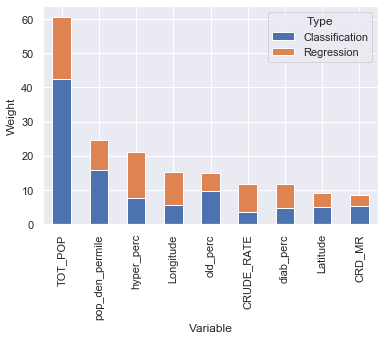

In [11]:
grp_d,data_penn,spc,sen = grp_sen_spc.grp_sen_spc_func(data_penn,vi_1,vi_3,compare_dt)
sns.set()
grp_d.plot(kind='bar', stacked=True)
plt.ylabel("Weight")
print("Sensitivity:")
print(sen)
print("Specificity:")
print(spc)

## Map Generation

In [14]:
map_1=cty_map.gen_map(data_penn,high_res_county_geo)
map_1
map_1.save('USA_Count_map.html')

In [15]:
map_1